In [15]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from imblearn.over_sampling import SMOTE

from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import ExtraTreesClassifier
from sklearn.linear_model import LogisticRegression
from xgboost import XGBClassifier
from sklearn.metrics import accuracy_score
from sklearn.preprocessing import LabelEncoder


In [16]:
df=pd.read_csv(r"C:\Users\Good Day\Desktop\Project 5\Copper_Set.xlsx - Result 1.csv")

C:\Users\Good Day\AppData\Local\Temp\ipykernel_2856\3495730302.py:1: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df=pd.read_csv(r"C:\Users\Good Day\Desktop\Project 5\Copper_Set.xlsx - Result 1.csv")


In [17]:
df.shape

(181673, 14)

In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 181673 entries, 0 to 181672
Data columns (total 14 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   id             181671 non-null  object 
 1   item_date      181672 non-null  float64
 2   quantity tons  181673 non-null  object 
 3   customer       181672 non-null  float64
 4   country        181645 non-null  float64
 5   status         181671 non-null  object 
 6   item type      181673 non-null  object 
 7   application    181649 non-null  float64
 8   thickness      181672 non-null  float64
 9   width          181673 non-null  float64
 10  material_ref   103754 non-null  object 
 11  product_ref    181673 non-null  int64  
 12  delivery date  181672 non-null  float64
 13  selling_price  181672 non-null  float64
dtypes: float64(8), int64(1), object(5)
memory usage: 19.4+ MB


In [18]:
df.isnull().sum()

id                   2
item_date            1
quantity tons        0
customer             1
country             28
status               2
item type            0
application         24
thickness            1
width                0
material_ref     77919
product_ref          0
delivery date        1
selling_price        1
dtype: int64

In [19]:
# since mat. ref column is null >50% and no useful data dropping the column.

df.drop(columns=['material_ref'], inplace=True)

In [20]:
df.isnull().sum()

id                2
item_date         1
quantity tons     0
customer          1
country          28
status            2
item type         0
application      24
thickness         1
width             0
product_ref       0
delivery date     1
selling_price     1
dtype: int64

In [51]:
df.shape

(181673, 13)

In [6]:
for index, value in df['item_date'].items():
    try:
        pd.to_datetime(value, format='%y%m%d')

    except:
        print(f"Error converting value: '{value} at index '{index}' to datetime")

Error converting value: '20210401.0 at index '0' to datetime
Error converting value: '20210401.0 at index '1' to datetime
Error converting value: '20210401.0 at index '2' to datetime
Error converting value: '20210401.0 at index '3' to datetime
Error converting value: '20210401.0 at index '4' to datetime
Error converting value: '20210401.0 at index '5' to datetime
Error converting value: '20210401.0 at index '6' to datetime
Error converting value: '20210401.0 at index '7' to datetime
Error converting value: '20210401.0 at index '8' to datetime
Error converting value: '20210401.0 at index '9' to datetime
Error converting value: '20210401.0 at index '10' to datetime
Error converting value: '20210401.0 at index '11' to datetime
Error converting value: '20210401.0 at index '12' to datetime
Error converting value: '20210401.0 at index '13' to datetime
Error converting value: '20210401.0 at index '14' to datetime
Error converting value: '20210401.0 at index '15' to datetime
Error converting v

In [67]:
for index, value in df['quantity tons'].items():

    try:
        df['quantity tons']=df['quantity tons'].astype('float64')

    except ValueError:
        print(f"Error '{value}' at index'{index}' to float")

Error '54.15113862' at index'0' to float
Error '768.0248392' at index'1' to float
Error '386.1279489' at index'2' to float
Error '202.4110654' at index'3' to float
Error '785.5262616' at index'4' to float
Error '225.7906761' at index'5' to float
Error '3.522612599' at index'6' to float
Error '113.3871236' at index'7' to float
Error '69.0718528' at index'8' to float
Error '630.6269167' at index'9' to float
Error '9.175769997' at index'10' to float
Error '113.9956655' at index'11' to float
Error '27.51254472' at index'12' to float
Error '32.23531688' at index'13' to float
Error '10.41134954' at index'14' to float
Error '35.31033249' at index'15' to float
Error '75.12439366' at index'16' to float
Error '20.80711354' at index'17' to float
Error '16.25398663' at index'18' to float
Error '53.58103351' at index'19' to float
Error '71.36697792' at index'20' to float
Error '471.8381804' at index'21' to float
Error '14.20357413' at index'22' to float
Error '53.72974562' at index'23' to float
Err

KeyboardInterrupt: 

In [21]:
rows_to_drop=[]

for index, value in df['quantity tons'].items():
    try:
        # Convert the individual value to float
        df.at[index, 'quantity tons'] = float(value)
    except ValueError:
        print(f"Error '{value}' at index '{index}' to float")
        rows_to_drop.append(index)

df.drop(index=rows_to_drop, inplace=True)


Error 'e' at index '173086' to float


In [22]:
# chaging the datatype to str to strip .0 at end

df['item_date']=df['item_date'].astype(str)
df['customer']=df['customer'].astype(str)
df['country']=df['country'].astype(str)
df['application']=df['application'].astype(str)
df['delivery date']=df['delivery date'].astype(str)



In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 181672 entries, 0 to 181672
Data columns (total 13 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   id             181670 non-null  object 
 1   item_date      181671 non-null  float64
 2   quantity tons  181672 non-null  object 
 3   customer       181672 non-null  object 
 4   country        181672 non-null  object 
 5   status         181670 non-null  object 
 6   item type      181672 non-null  object 
 7   application    181672 non-null  object 
 8   thickness      181671 non-null  float64
 9   width          181672 non-null  float64
 10  product_ref    181672 non-null  int64  
 11  delivery date  181671 non-null  float64
 12  selling_price  181671 non-null  float64
dtypes: float64(5), int64(1), object(7)
memory usage: 19.4+ MB


In [23]:
df['item_date']= df['item_date'].astype(str).str.strip('.0')
df['application']=df['application'].astype(str).str.strip('.0')
df['country']=df['country'].astype(str).str.strip('.0')
df['customer']=df['customer'].astype(str).str.strip('.0')
df['delivery date']=df['delivery date'].astype(str).str.strip('.0')

In [32]:
for index, value in df['item_date'].items():
    try:
        pd.to_datetime(value, format='%Y%m%d')

    except ValueError:
        print(f"Error '{value}' at index '{index}' to datetime")

Error '2021-04-01' at index '0' to datetime
Error '2021-04-01' at index '1' to datetime
Error '2021-04-01' at index '2' to datetime
Error '2021-04-01' at index '3' to datetime
Error '2021-04-01' at index '4' to datetime
Error '2021-04-01' at index '5' to datetime
Error '2021-04-01' at index '6' to datetime
Error '2021-04-01' at index '7' to datetime
Error '2021-04-01' at index '8' to datetime
Error '2021-04-01' at index '9' to datetime
Error '2021-04-01' at index '10' to datetime
Error '2021-04-01' at index '11' to datetime
Error '2021-04-01' at index '12' to datetime
Error '2021-04-01' at index '13' to datetime
Error '2021-04-01' at index '14' to datetime
Error '2021-04-01' at index '15' to datetime
Error '2021-04-01' at index '16' to datetime
Error '2021-04-01' at index '17' to datetime
Error '2021-04-01' at index '18' to datetime
Error '2021-04-01' at index '19' to datetime
Error '2021-04-01' at index '20' to datetime
Error '2021-04-01' at index '21' to datetime
Error '2021-04-01' a

KeyboardInterrupt: 

In [24]:
df['item_date']=pd.to_datetime(df['item_date'], format='%Y%m%d', errors='coerce')

In [25]:
df['item_date'].isna().sum()

3

In [26]:
df.dropna(subset=['item_date'], inplace=True)

In [11]:
for index, value in df['delivery date'].items():

    try:
        pd.to_datetime(value, format='%Y%m%d')

    except ValueError:
        print(f"Error '{value}' at index '{index}' to datetime")

Error '30310101' at index '58' to datetime
Error '20212222' at index '105421' to datetime


In [27]:
df['delivery date']=pd.to_datetime(df['delivery date'], format='%Y%m%d', errors='coerce')

In [28]:
df.dropna(subset=['delivery date'], inplace=True)

In [15]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 181666 entries, 0 to 181672
Data columns (total 13 columns):
 #   Column         Non-Null Count   Dtype         
---  ------         --------------   -----         
 0   id             181664 non-null  object        
 1   item_date      181666 non-null  datetime64[ns]
 2   quantity tons  181666 non-null  object        
 3   customer       181666 non-null  object        
 4   country        181666 non-null  object        
 5   status         181664 non-null  object        
 6   item type      181666 non-null  object        
 7   application    181666 non-null  object        
 8   thickness      181665 non-null  float64       
 9   width          181666 non-null  float64       
 10  product_ref    181666 non-null  int64         
 11  delivery date  181666 non-null  datetime64[ns]
 12  selling_price  181665 non-null  float64       
dtypes: datetime64[ns](2), float64(3), int64(1), object(7)
memory usage: 19.4+ MB


In [29]:
df.isnull().sum()

id               2
item_date        0
quantity tons    0
customer         0
country          0
status           2
item type        0
application      0
thickness        1
width            0
product_ref      0
delivery date    0
selling_price    1
dtype: int64

In [30]:
# since null values are <1% filling the data with mean, median and mode method

# df['item_date'].fillna(df['item_date'].mode().iloc[0])
# df['item_date'] = df['item_date'].fillna(df['item_date'].median().iloc[0], inplace=True)

# df['customer'].fillna(df['customer'].mode(), inplace=True)
# df['country'].fillna(df['country'].mode(), inplace=True)
df['status']=df['status'].fillna(df['status'].mode().iloc[0])
# df['application'].fillna(df['application'].mode(), inplace=True)
# df['delivery date'].fillna(df['delivery date'].mode(), inplace=True)

df['thickness']=df['thickness'].fillna(df['thickness'].mean())

df['selling_price']=df['selling_price'].fillna(df['selling_price'].median())

In [31]:
df.isnull().sum()

id               2
item_date        0
quantity tons    0
customer         0
country          0
status           0
item type        0
application      0
thickness        0
width            0
product_ref      0
delivery date    0
selling_price    0
dtype: int64

In [21]:
df.info()

# since id is unique value and not important in statistical point so not dropping and filling the data

<class 'pandas.core.frame.DataFrame'>
Index: 181666 entries, 0 to 181672
Data columns (total 13 columns):
 #   Column         Non-Null Count   Dtype         
---  ------         --------------   -----         
 0   id             181664 non-null  object        
 1   item_date      181666 non-null  datetime64[ns]
 2   quantity tons  181666 non-null  object        
 3   customer       181666 non-null  object        
 4   country        181666 non-null  object        
 5   status         181666 non-null  object        
 6   item type      181666 non-null  object        
 7   application    181666 non-null  object        
 8   thickness      181666 non-null  float64       
 9   width          181666 non-null  float64       
 10  product_ref    181666 non-null  int64         
 11  delivery date  181666 non-null  datetime64[ns]
 12  selling_price  181666 non-null  float64       
dtypes: datetime64[ns](2), float64(3), int64(1), object(7)
memory usage: 19.4+ MB


In [32]:
# Assuming 'df' is your DataFrame and 'customer' is the name of the column
unique_customers_count = df['customer'].nunique()

# Display the count of unique customers
print(unique_customers_count)

1170


In [33]:
# Assuming 'df' is your DataFrame and 'country' is the name of the column
unique_country_count = df['country'].unique()

# Display the count of unique customers
unique_country_count

array(['28', '25', '3', '32', '38', '78', '27', '77', '113', '79', '26',
       '39', '4', '84', '8', '107', '89', 'nan'], dtype=object)

In [34]:
nan_count = df['country'].isna().sum()
print(nan_count)


0


In [35]:
df['status'].unique()

array(['Won', 'Draft', 'To be approved', 'Lost', 'Not lost for AM',
       'Wonderful', 'Revised', 'Offered', 'Offerable'], dtype=object)

In [36]:
df['item type'].unique()

array(['W', 'WI', 'S', 'Others', 'PL', 'IPL', 'SLAWR'], dtype=object)

In [37]:
app=df['application'].unique()
print(app)

['1' '41' '28' '59' '15' '4' '38' '56' '42' '26' '27' '19' '2' '66' '29'
 '22' '25' '67' '79' '3' '99' '5' '39' '69' '7' '65' '58' '68' 'nan']


In [14]:
unique_product_ref_count=df['product_ref'].unique()
print(unique_product_ref_count)

[1670798778 1668701718     628377     640665     611993 1668701376
  164141591 1671863738 1332077137     640405 1693867550 1665572374
 1282007633 1668701698     628117 1690738206     628112     640400
 1671876026  164336407  164337175 1668701725 1665572032     611728
 1721130331 1693867563     611733 1690738219 1722207579  929423819
 1665584320 1665584662 1665584642]


In [38]:
# changing the categorical value to numerical value by encoding method.
# columns status and item type are categorical value

import category_encoders as ce
# encode categorical variables with ordinal encoding

encoder=ce.OrdinalEncoder(cols=['status', 'item type'])

df_encoded= encoder.fit_transform(df)


In [39]:
# Get the mapping information from the encoder
encoder_mapping = encoder.category_mapping

# Extract the mapping for 'status' and 'item type'
status_mapping = encoder_mapping[0]['mapping']
item_type_mapping = encoder_mapping[1]['mapping']

# Print the mappings
print("Status Mapping:")
for encoded_value, original_value in status_mapping.items():
    print(f"{encoded_value}: {original_value}")
    
print("\nItem Type Mapping:")
for encoded_value, original_value in item_type_mapping.items():
    print(f"{encoded_value}: {original_value}")


Status Mapping:
Won: 1
Draft: 2
To be approved: 3
Lost: 4
Not lost for AM: 5
Wonderful: 6
Revised: 7
Offered: 8
Offerable: 9
nan: -2

Item Type Mapping:
W: 1
WI: 2
S: 3
Others: 4
PL: 5
IPL: 6
SLAWR: 7
nan: -2


In [40]:
df_encoded.head()

,id,item_date,quantity tons,customer,country,status,item type,application,thickness,width,product_ref,delivery date,selling_price
0,EC06F063-9DF0-440C-8764-0B0C05A4F6AE,2021-04-01,54.151139,30156308,28,1,1,1,2.00,1500.0,1670798778,2021-07-01,854.00
1,4E5F4B3D-DDDF-499D-AFDE-A3227EC49425,2021-04-01,768.024839,30202938,25,1,1,41,0.80,1210.0,1668701718,2021-04-01,1047.00
2,E140FF1B-2407-4C02-A0DD-780A093B1158,2021-04-01,386.127949,30153963,3,1,2,28,0.38,952.0,628377,2021-01-01,644.33
3,F8D507A0-9C62-4EFE-831E-33E1DA53BB50,2021-04-01,202.411065,30349574,32,1,3,59,2.30,1317.0,1668701718,2021-01-01,768.00
4,4E1C4E78-152B-430A-8094-ADD889C9D0AD,2021-04-01,785.526262,3021156,28,1,1,1,4.00,2000.0,640665,2021-03-01,577.00


In [41]:
# Find duplicates id
duplicates = df_encoded.duplicated(subset = 'id', keep = False)
print(duplicates.sum())

# Remove identical duplicates since same values in entire row 

df_1 = df_encoded.drop_duplicates()



2


In [42]:
df_1.info()

<class 'pandas.core.frame.DataFrame'>
Index: 181666 entries, 0 to 181672
Data columns (total 13 columns):
 #   Column         Non-Null Count   Dtype         
---  ------         --------------   -----         
 0   id             181664 non-null  object        
 1   item_date      181666 non-null  datetime64[ns]
 2   quantity tons  181666 non-null  object        
 3   customer       181666 non-null  object        
 4   country        181666 non-null  object        
 5   status         181666 non-null  int32         
 6   item type      181666 non-null  int32         
 7   application    181666 non-null  object        
 8   thickness      181666 non-null  float64       
 9   width          181666 non-null  float64       
 10  product_ref    181666 non-null  int64         
 11  delivery date  181666 non-null  datetime64[ns]
 12  selling_price  181666 non-null  float64       
dtypes: datetime64[ns](2), float64(3), int32(2), int64(1), object(5)
memory usage: 18.0+ MB


In [21]:
from datetime import datetime

today=datetime.today().date()

# Are there item date in the future?
df_1[df_1['item_date'].dt.date > today]


,id,item_date,quantity tons,customer,country,status,item type,application,thickness,width,product_ref,delivery date,selling_price


In [26]:
# are there any item date after delivery date?

inconsistent_date= df_1 [df_1['item_date'].dt.date>df_1['delivery date'].dt.date]
inconsistent_date

# leaving as it, may be item taken for supply after the targetted date.

,id,item_date,quantity tons,customer,country,status,item type,application,thickness,width,product_ref,delivery date,selling_price
2,E140FF1B-2407-4C02-A0DD-780A093B1158,2021-04-01,386.127949,30153963,3,1,2,28,0.38,952.0,628377,2021-01-01,644.33
3,F8D507A0-9C62-4EFE-831E-33E1DA53BB50,2021-04-01,202.411065,30349574,32,1,3,59,2.30,1317.0,1668701718,2021-01-01,768.00
4,4E1C4E78-152B-430A-8094-ADD889C9D0AD,2021-04-01,785.526262,3021156,28,1,1,1,4.00,2000.0,640665,2021-03-01,577.00
7,AA3F18A2-A7D6-43DE-8644-F0632AE2CB68,2021-04-01,113.387124,30342192,32,1,1,41,0.68,1220.0,611993,2021-01-01,931.00
11,CA076845-2EDE-4C02-95BE-6C7B842026E8,2021-04-01,113.995666,30342192,32,1,1,41,0.55,1220.0,611993,2021-01-01,954.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...
181668,DE633116-D1DF-4846-982E-55EFC3658A76,2020-07-02,102.482422,30200854,25,1,1,41,0.96,1220.0,164141591,2020-07-01,591.00
181669,A48374B1-E6DB-45F2-889A-1F9C27C099EB,2020-07-02,208.086469,30200854,25,1,1,41,0.95,1500.0,164141591,2020-07-01,589.00
181670,91643238-5C7B-4237-9A5F-63AE3D35F320,2020-07-02,4.235594,30200854,25,1,1,41,0.71,1250.0,164141591,2020-07-01,619.00
181671,7AFFD323-01D9-4E15-B80D-7D1B03498FC8,2020-07-02,-2000.0,30200854,25,1,1,41,0.85,1250.0,164141591,2020-07-01,601.00


In [69]:
df_encoded['status'].unique()

array([1, 2, 3, 4, 5, 6, 7, 8, 9])

In [23]:
df_encoded['item type'].unique()

array([1, 2, 3, 4, 5, 6, 7])

In [23]:
df_1['quantity tons'].min()

-2000.0

In [58]:
df_1['quantity tons']

0          54.151139
1         768.024839
2         386.127949
3         202.411065
4         785.526262
             ...    
181668    102.482422
181669    208.086469
181670      4.235594
181671       -2000.0
181672    406.686538
Name: quantity tons, Length: 181666, dtype: object

In [25]:
df_1.info()

<class 'pandas.core.frame.DataFrame'>
Index: 181662 entries, 0 to 181672
Data columns (total 13 columns):
 #   Column         Non-Null Count   Dtype         
---  ------         --------------   -----         
 0   id             181660 non-null  object        
 1   item_date      181662 non-null  datetime64[ns]
 2   quantity tons  181662 non-null  object        
 3   customer       181662 non-null  object        
 4   country        181662 non-null  object        
 5   status         181662 non-null  int32         
 6   item type      181662 non-null  int32         
 7   application    181662 non-null  object        
 8   thickness      181662 non-null  float64       
 9   width          181662 non-null  float64       
 10  product_ref    181662 non-null  int64         
 11  delivery date  181662 non-null  datetime64[ns]
 12  selling_price  181662 non-null  float64       
dtypes: datetime64[ns](2), float64(3), int32(2), int64(1), object(5)
memory usage: 18.0+ MB


In [43]:
# Convert columns to integer after handling missing values
df_1['quantity tons'] = pd.to_numeric(df_1['quantity tons'], errors='coerce')
df_1['customer'] = pd.to_numeric(df_1['customer'], errors='coerce')
df_1['country'] = pd.to_numeric(df_1['country'], errors='coerce')
df_1['status'] = pd.to_numeric(df_1['status'], errors='coerce')
df_1['item type'] = pd.to_numeric(df_1['item type'], errors='coerce')
df_1['application'] = pd.to_numeric(df_1['application'], errors='coerce')


In [44]:
# Since quantity column should not be in negative value, data to be cleaned since negative values present.

df_1=df_1[df_1['quantity tons']>=0]

In [45]:

df_1.isnull().sum()

id                2
item_date         0
quantity tons     0
customer          1
country          28
status            0
item type         0
application      24
thickness         0
width             0
product_ref       0
delivery date     0
selling_price     0
dtype: int64

In [46]:
df_1['country']=df_1['country'].fillna(df_1['country'].mode().iloc[0])
df_1['customer']=df_1['customer'].fillna(df_1['customer'].mode().iloc[0])
df_1['application']=df_1['application'].fillna(df_1['application'].mode().iloc[0])
df_1['quantity tons']=df_1['quantity tons'].fillna(df_1['quantity tons'].mode().iloc[0])
# df_1.dropna(inplace=True)


In [47]:
df_1.isnull().sum()

id               2
item_date        0
quantity tons    0
customer         0
country          0
status           0
item type        0
application      0
thickness        0
width            0
product_ref      0
delivery date    0
selling_price    0
dtype: int64

In [48]:
df_2=df_1.copy()

In [49]:
df_2.info()

<class 'pandas.core.frame.DataFrame'>
Index: 181662 entries, 0 to 181672
Data columns (total 13 columns):
 #   Column         Non-Null Count   Dtype         
---  ------         --------------   -----         
 0   id             181660 non-null  object        
 1   item_date      181662 non-null  datetime64[ns]
 2   quantity tons  181662 non-null  float64       
 3   customer       181662 non-null  float64       
 4   country        181662 non-null  float64       
 5   status         181662 non-null  int32         
 6   item type      181662 non-null  int32         
 7   application    181662 non-null  float64       
 8   thickness      181662 non-null  float64       
 9   width          181662 non-null  float64       
 10  product_ref    181662 non-null  int64         
 11  delivery date  181662 non-null  datetime64[ns]
 12  selling_price  181662 non-null  float64       
dtypes: datetime64[ns](2), float64(7), int32(2), int64(1), object(1)
memory usage: 18.0+ MB


In [50]:
df_2.isnull().sum()

id               2
item_date        0
quantity tons    0
customer         0
country          0
status           0
item type        0
application      0
thickness        0
width            0
product_ref      0
delivery date    0
selling_price    0
dtype: int64

In [23]:
# def plot(df, column):

#     plt.figure(figsize=(20,5))
#     plt.subplot(1,3,1)
#     sns.boxplot(data=df, x=column)
#     plt.title(f'Box Plot for {column}')

#     plt.subplot(1,3,2)
#     sns.histplot(data=df, x=column, kde=True)
#     plt.title(f'Distribution PLot for {column}')

#     plt.subplot(1,3,3)
#     sns.violinplot(data=df, x=column)
#     plt.title(f'Violin Plot for {column}')
#     plt.show()

In [ ]:
# for i in ['quantity tons']:
#     plot(df_2, i)

C:\Users\Good Day\AppData\Local\Temp\ipykernel_3456\3774021407.py:5: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df_2['quantity tons'], ax=axes[0])


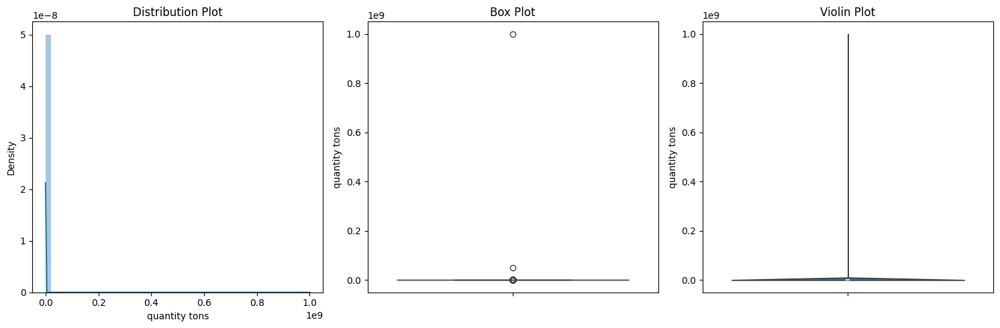

In [82]:


# # Create subplots with 1 row and 3 columns
# fig, axes = plt.subplots(1, 3, figsize=(15, 5))

# # Create the plots and set titles
# sns.distplot(df_2['quantity tons'], ax=axes[0])
# axes[0].set_title('Distribution Plot')

# sns.boxplot(df_2['quantity tons'], ax=axes[1])
# axes[1].set_title('Box Plot')

# sns.violinplot(df_2['quantity tons'], ax=axes[2])
# axes[2].set_title('Violin Plot')

# # Adjust layout
# plt.tight_layout()

# # Show the plots
# plt.show()


# Outliers can be trimmed/ capping techniques to overcome


In [51]:
# checking skewness in each column. 
skewness = df_2['quantity tons'].skew()
print("Skewness of 'quantity tons' column:", skewness)

skewness = df_2['customer'].skew()
print("Skewness of 'customer' column:", skewness)

skewness = df_2['country'].skew()
print("Skewness of 'country' column:", skewness)

skewness = df_2['status'].skew()
print("Skewness of 'status' column:", skewness)

skewness = df_2['application'].skew()
print("Skewness of 'application' column:", skewness)

skewness = df_2['thickness'].skew()
print("Skewness of 'thickness' column:", skewness)


skewness = df_2['width'].skew()
print("Skewness of 'width ' column:", skewness)

skewness = df_2['selling_price'].skew()
print("Skewness of 'selling_price' column:", skewness)


Skewness of 'quantity tons' column: 424.6779590953564
Skewness of 'customer' column: 74.0503063438673
Skewness of 'country' column: 0.5919579092307995
Skewness of 'status' column: 0.9872401074074755
Skewness of 'application' column: 0.5144208003571535
Skewness of 'thickness' column: 303.4401729464671
Skewness of 'width ' column: 0.37459525757414996
Skewness of 'selling_price' column: 301.3789633660907


In [52]:
df_2.to_csv('processed_data.csv', index=False)

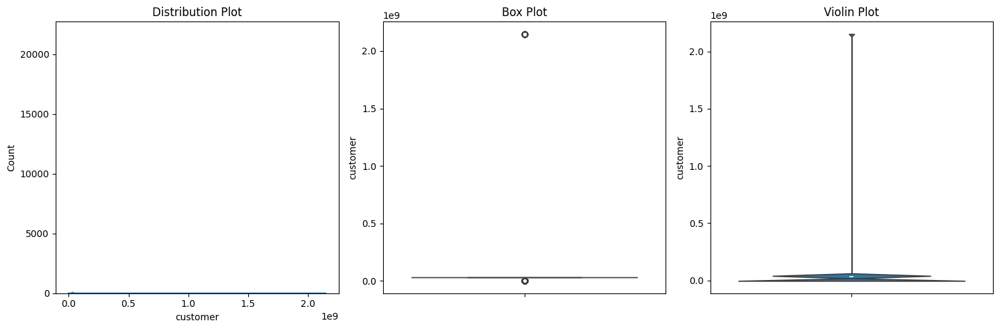

In [83]:
# # Create subplots with 1 row and 3 columns
# fig, axes = plt.subplots(1, 3, figsize=(15, 5))

# # Create the plots and set titles
# sns.histplot(df_1['customer'], ax=axes[0], kde=True)
# axes[0].set_title('Distribution Plot')

# sns.boxplot(y=df_1['customer'], ax=axes[1])
# axes[1].set_title('Box Plot')

# sns.violinplot(y=df_1['customer'], ax=axes[2])
# axes[2].set_title('Violin Plot')

# # Adjust layout
# plt.tight_layout()

# # Show the plots
# plt.show()


C:\Users\Good Day\AppData\Local\Temp\ipykernel_3456\733431331.py:5: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df_1['country'], ax=axes[0])


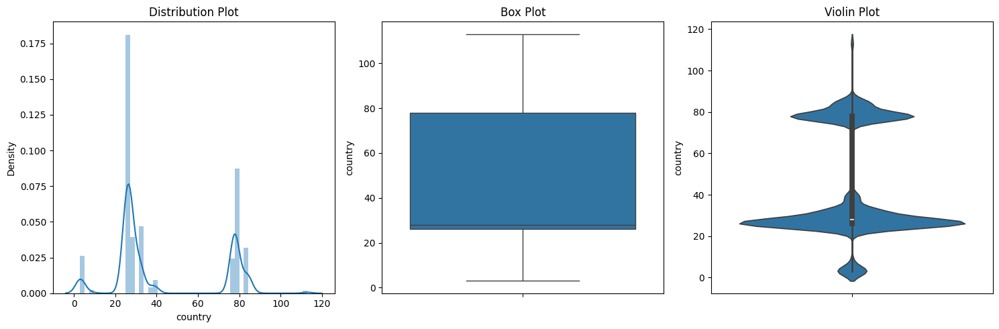

In [80]:
# # Create subplots with 1 row and 3 columns
# fig, axes = plt.subplots(1, 3, figsize= (15,5))

# # Create the plots and set titles
# sns.distplot(df_1['country'], ax=axes[0])
# axes[0].set_title('Distribution Plot')

# sns.boxplot(df_1['country'], ax=axes[1])
# axes[1].set_title('Box Plot')

# sns.violinplot(df_1['country'], ax=axes[2])
# axes[2].set_title('Violin Plot')

# # Adjust layout
# plt.tight_layout()

# # Show the plots
# plt.show()

c:\Users\Good Day\AppData\Local\Programs\Python\Python312\Lib\site-packages\seaborn\distributions.py:2125: UserWarning: `displot` is a figure-level function and does not accept the ax= parameter. You may wish to try histplot.
  warnings.warn(msg, UserWarning)


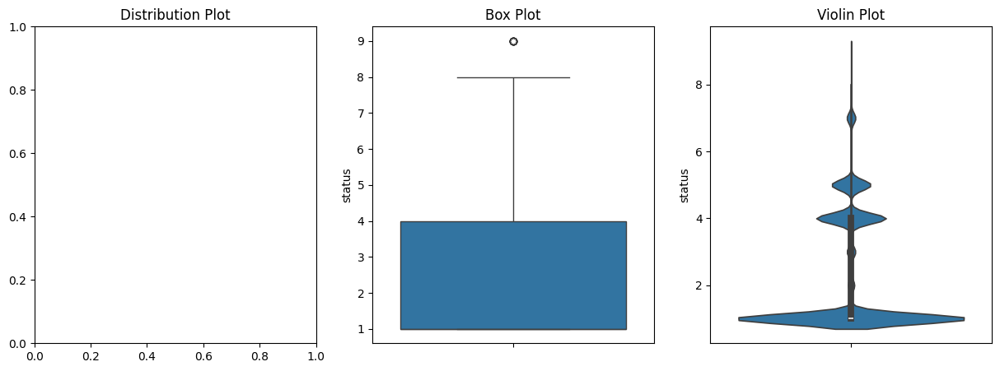

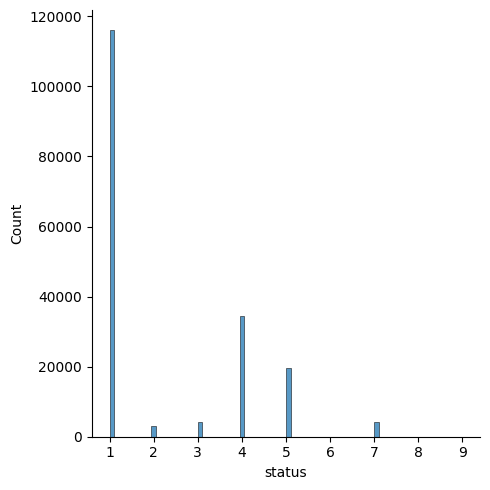

In [32]:
# Create subplots with 1 row and 3 columns
# fig, axes = plt.subplots(1, 3, figsize= (15,5))


# # Create the plots and set titles
# sns.displot(df_1['status'], ax=axes[0])
# axes[0].set_title('Distribution Plot')

# sns.boxplot(df_1['status'], ax=axes[1])
# axes[1].set_title('Box Plot')


# sns.violinplot(df_1['status'], ax=axes[2])
# axes[2].set_title('Violin Plot')

# # Adjust layout
# plt.tight_layout()


# # Show the plots
# plt.show()

c:\Users\Good Day\AppData\Local\Programs\Python\Python312\Lib\site-packages\seaborn\distributions.py:2125: UserWarning: `displot` is a figure-level function and does not accept the ax= parameter. You may wish to try histplot.
  warnings.warn(msg, UserWarning)


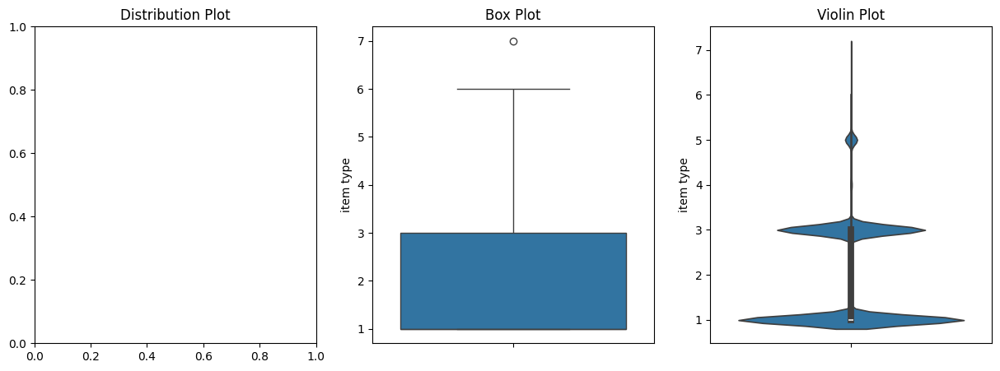

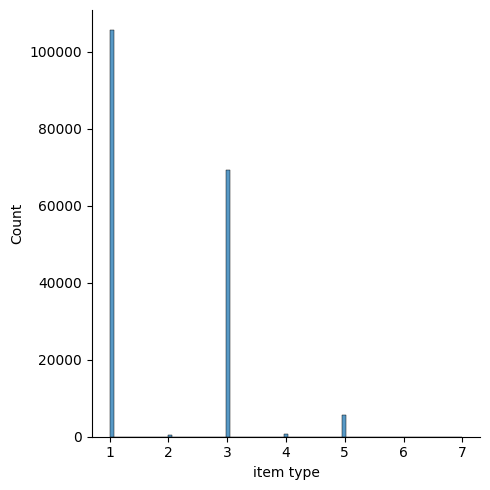

In [81]:
# Create subplots with 1 row and 3 columns
fig, axes = plt.subplots(1, 3, figsize= (15,5))


# # Create the plots and set titles
# sns.displot(df_1['item type'], ax=axes[0])
# axes[0].set_title('Distribution Plot')

# sns.boxplot(df_1['item type'], ax=axes[1])
# axes[1].set_title('Box Plot')


# sns.violinplot(df_1['item type'], ax=axes[2])
# axes[2].set_title('Violin Plot')

# # Adjust layout
# plt.tight_layout()


# # Show the plots
# plt.show()

c:\Users\Good Day\AppData\Local\Programs\Python\Python312\Lib\site-packages\seaborn\distributions.py:2125: UserWarning: `displot` is a figure-level function and does not accept the ax= parameter. You may wish to try histplot.
  warnings.warn(msg, UserWarning)


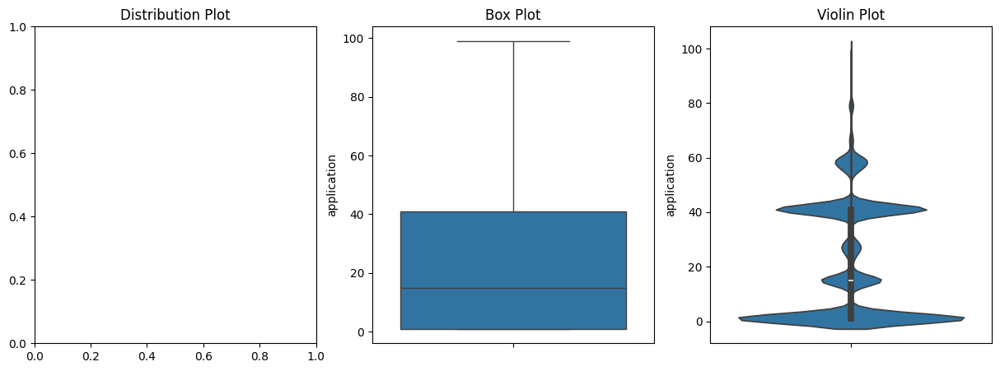

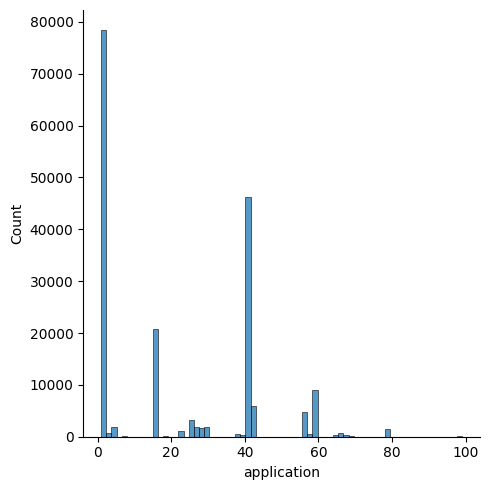

In [34]:
# Create subplots with 1 row and 3 columns
# fig, axes = plt.subplots(1, 3, figsize= (15,5))


# # Create the plots and set titles
# sns.displot(df_1['application'], ax=axes[0])
# axes[0].set_title('Distribution Plot')

# sns.boxplot(df_1['application'], ax=axes[1])
# axes[1].set_title('Box Plot')


# sns.violinplot(df_1['application'], ax=axes[2])
# axes[2].set_title('Violin Plot')

# # Adjust layout
# plt.tight_layout()


# # Show the plots
# plt.show()

c:\Users\Good Day\AppData\Local\Programs\Python\Python312\Lib\site-packages\seaborn\distributions.py:2125: UserWarning: `displot` is a figure-level function and does not accept the ax= parameter. You may wish to try histplot.
  warnings.warn(msg, UserWarning)


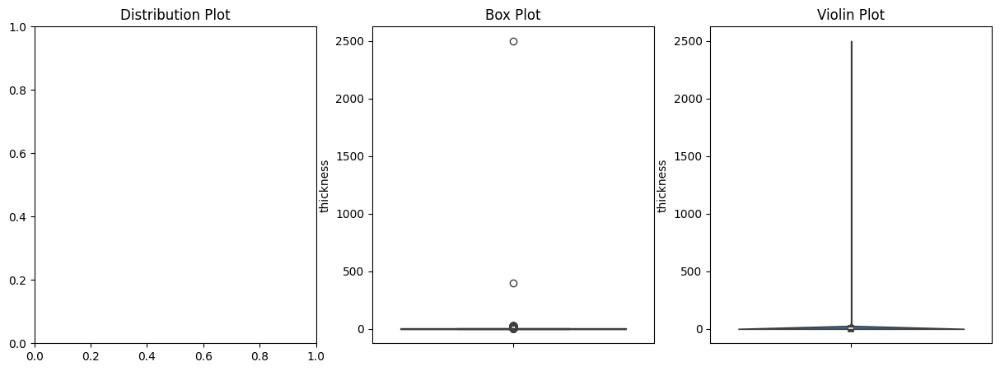

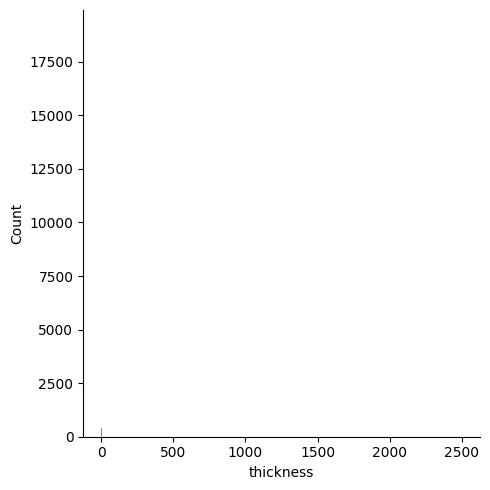

In [35]:
# Create subplots with 1 row and 3 columns
# fig, axes = plt.subplots(1, 3, figsize= (15,5))


# # Create the plots and set titles
# sns.displot(df_1['thickness'], ax=axes[0])
# axes[0].set_title('Distribution Plot')

# sns.boxplot(df_1['thickness'], ax=axes[1])
# axes[1].set_title('Box Plot')


# sns.violinplot(df_1['thickness'], ax=axes[2])
# axes[2].set_title('Violin Plot')

# # Adjust layout
# plt.tight_layout()


# # Show the plots
# plt.show()

c:\Users\Good Day\AppData\Local\Programs\Python\Python312\Lib\site-packages\seaborn\distributions.py:2125: UserWarning: `displot` is a figure-level function and does not accept the ax= parameter. You may wish to try histplot.
  warnings.warn(msg, UserWarning)


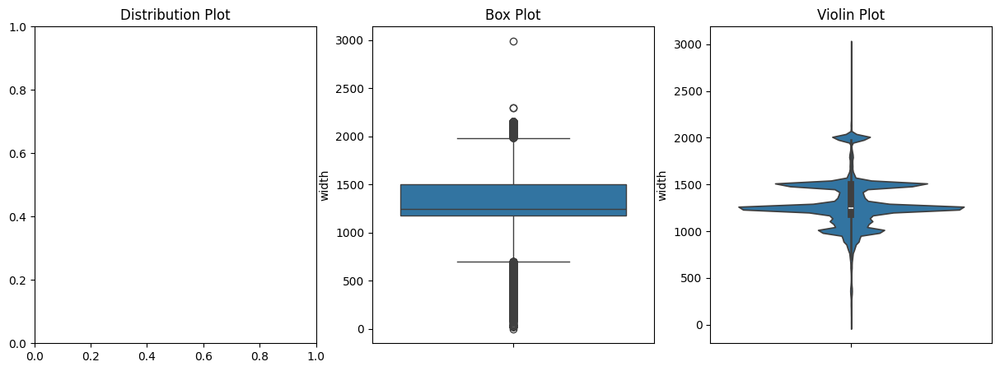

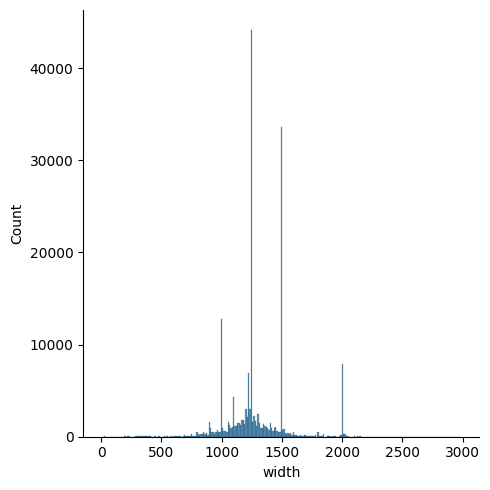

In [36]:
# Create subplots with 1 row and 3 columns
# fig, axes = plt.subplots(1, 3, figsize= (15,5))


# # Create the plots and set titles
# sns.displot(df_1['width'], ax=axes[0])
# axes[0].set_title('Distribution Plot')

# sns.boxplot(df_1['width'], ax=axes[1])
# axes[1].set_title('Box Plot')


# sns.violinplot(df_1['width'], ax=axes[2])
# axes[2].set_title('Violin Plot')

# # Adjust layout
# plt.tight_layout()


# # Show the plots
# plt.show()

In [52]:
# Create subplots with 1 row and 3 columns
# fig, axes = plt.subplots(1, 3, figsize= (15,5))


# # Create the plots and set titles
# sns.displot(df_1['selling_price'], ax=axes[0])
# axes[0].set_title('Distribution Plot')

# sns.boxplot(df_1['selling_price'], ax=axes[1])
# axes[1].set_title('Box Plot')


# sns.violinplot(df_1['selling_price'], ax=axes[2])
# axes[2].set_title('Violin Plot')

# # Adjust layout
# plt.tight_layout()


# # Show the plots
# plt.show()

c:\Users\Good Day\AppData\Local\Programs\Python\Python312\Lib\site-packages\seaborn\distributions.py:2125: UserWarning: `displot` is a figure-level function and does not accept the ax= parameter. You may wish to try histplot.
  warnings.warn(msg, UserWarning)
Exception ignored in: <function TransformNode.set_children.<locals>.<lambda> at 0x000002260E4C6840>
Traceback (most recent call last):
  File "c:\Users\Good Day\AppData\Local\Programs\Python\Python312\Lib\site-packages\matplotlib\transforms.py", line 198, in <lambda>
    self, lambda _, pop=child._parents.pop, k=id_self: pop(k))

KeyboardInterrupt: 


KeyboardInterrupt: 

In [84]:
# quantity tons, thickness and selling price is rigth skewed, log transformation.

def transform(df, column):
    df[column]=np.log(df[column])
    return df[column]

transform(df_2, 'quantity tons')
transform(df_2, 'thickness')
transform(df_2, 'selling_price')

c:\Users\Good Day\AppData\Local\Programs\Python\Python312\Lib\site-packages\pandas\core\arraylike.py:399: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
c:\Users\Good Day\AppData\Local\Programs\Python\Python312\Lib\site-packages\pandas\core\arraylike.py:399: RuntimeWarning: invalid value encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


0         6.749931
1         6.953684
2         6.468211
3         6.643790
4         6.357842
            ...   
181667    6.400257
181668    6.381816
181669    6.378426
181670    6.428105
181672    6.408529
Name: selling_price, Length: 181662, dtype: float64

In [85]:
def plot(df, column):

    plt.figure(figsize=(20,5))
    plt.subplot(1,3,1)
    sns.boxplot(data=df, x=column)
    plt.title(f'Box Plot for {column}')

    plt.subplot(1,3,2)
    sns.histplot(data=df, x=column, kde=True)
    plt.title(f'Distribution PLot for {column}')

    plt.subplot(1,3,3)
    sns.violinplot(data=df, x=column)
    plt.title(f'Violin Plot for {column}')
    plt.show()
    


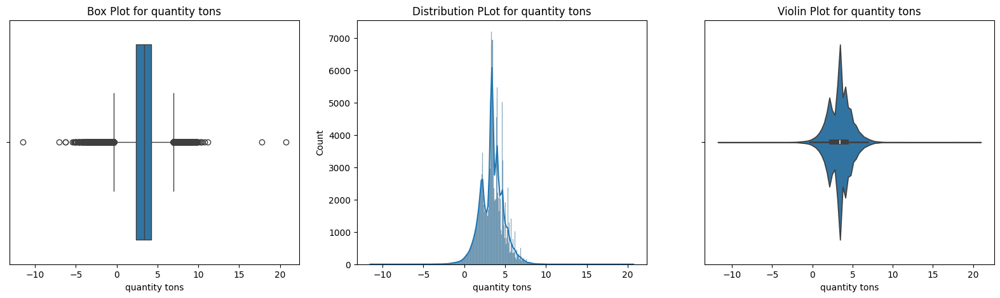

In [86]:
for i in ['quantity tons', 'customer', 'country', 'item type', 'application', 'thickness', 'width', 'selling_price']:
    plot(df_2, i)

In [142]:
# Treating the outliers using IQR

def outlier(df, column):
    percentile25=df[column].quantile(0.25)
    percentile75=df[column].quantile(0.75)
    iqr=percentile75-percentile25

    upper_limit=percentile75+1.5*iqr
    lower_limit=percentile25-1.5*iqr

    # Replace outliers with upper or lower limit
    df[column] = df[column].apply(lambda x: upper_limit if x > upper_limit else (lower_limit if x < lower_limit else x))
    return df[column]
    



outlier(df_2, 'quantity tons')
outlier(df_2, 'thickness')
outlier(df_2, 'width')
outlier(df_2, 'selling_price')

0          854.00
1         1047.00
2          644.33
3          768.00
4          577.00
           ...   
181667     602.00
181668     591.00
181669     589.00
181670     619.00
181672     607.00
Name: selling_price, Length: 181631, dtype: float64

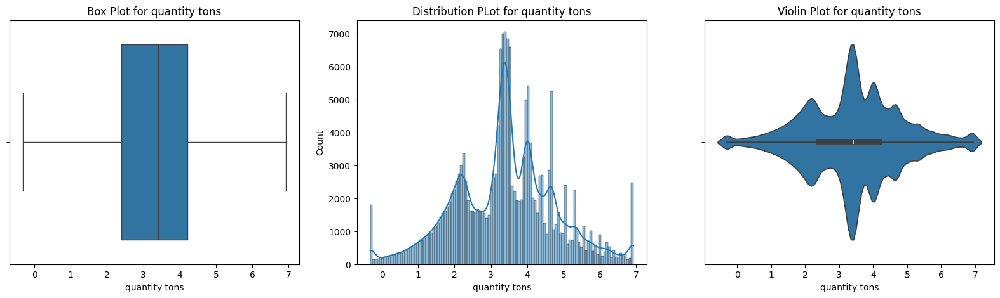

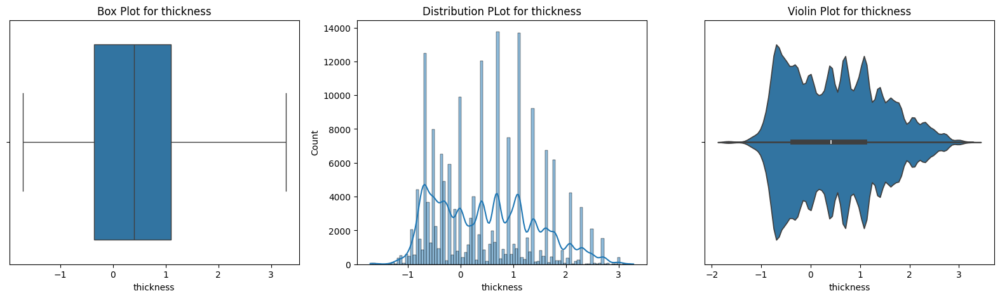

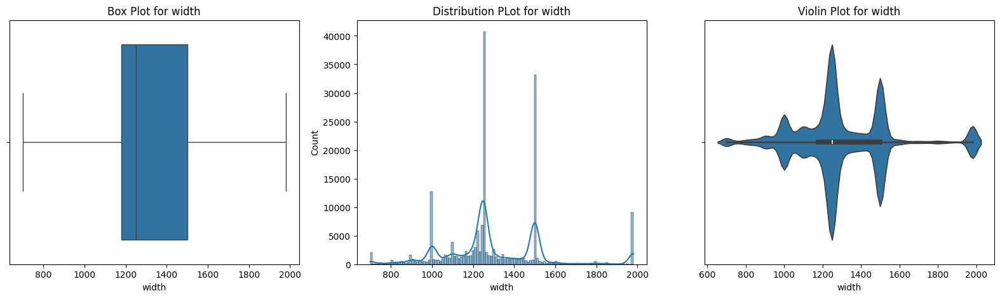

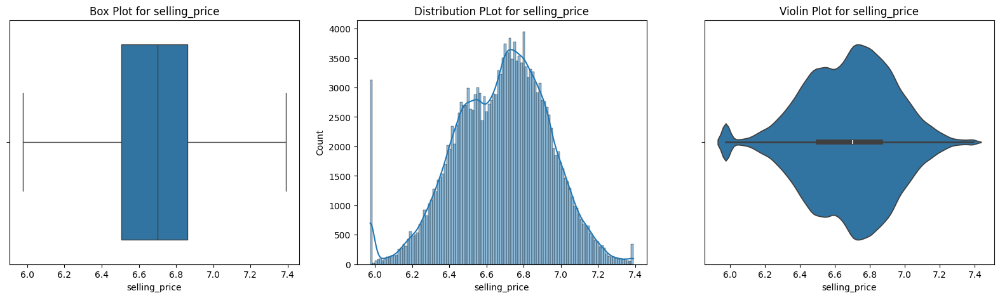

In [85]:
for i in ['quantity tons','thickness', 'width', 'selling_price']:
    plot(df_2, i)

<Axes: >

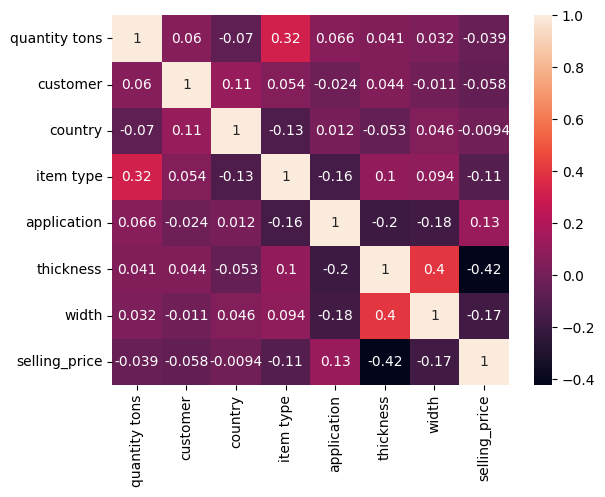

In [126]:
col=['quantity tons', 'customer', 'country', 'item type', 'application', 'thickness', 'width', 'selling_price']
heatmap=df_2[col].corr()
sns.heatmap(heatmap, annot=True)

In [127]:
df_2

,id,item_date,quantity tons,customer,country,status,item type,application,thickness,width,product_ref,delivery date,selling_price
0,EC06F063-9DF0-440C-8764-0B0C05A4F6AE,2021-04-01,3.991779,30156308,28,1,1,1,0.693147,1500.00,1670798778,2021-07-01,6.749931
1,4E5F4B3D-DDDF-499D-AFDE-A3227EC49425,2021-04-01,6.643822,30202938,25,1,1,41,-0.223144,1210.00,1668701718,2021-04-01,6.953684
2,E140FF1B-2407-4C02-A0DD-780A093B1158,2021-04-01,5.956169,30153963,3,1,2,28,-0.967584,952.00,628377,2021-01-01,6.468211
3,F8D507A0-9C62-4EFE-831E-33E1DA53BB50,2021-04-01,5.310301,30349574,32,1,3,59,0.832909,1317.00,1668701718,2021-01-01,6.643790
4,4E1C4E78-152B-430A-8094-ADD889C9D0AD,2021-04-01,6.666354,3021156,28,1,1,1,1.386294,1980.75,640665,2021-03-01,6.357842
...,...,...,...,...,...,...,...,...,...,...,...,...,...
181667,0B812591-B501-4F34-859A-B06381FAEB44,2020-07-02,4.670802,30200854,25,1,1,41,-0.040822,1240.00,164141591,2020-07-01,6.400257
181668,DE633116-D1DF-4846-982E-55EFC3658A76,2020-07-02,4.629691,30200854,25,1,1,41,-0.040822,1220.00,164141591,2020-07-01,6.381816
181669,A48374B1-E6DB-45F2-889A-1F9C27C099EB,2020-07-02,5.337954,30200854,25,1,1,41,-0.051293,1500.00,164141591,2020-07-01,6.378426
181670,91643238-5C7B-4237-9A5F-63AE3D35F320,2020-07-02,1.443523,30200854,25,1,1,41,-0.342490,1250.00,164141591,2020-07-01,6.428105


In [143]:
df_scaled=df_2.copy()

In [144]:
col_names=['quantity tons','customer','country','item type','application','thickness','width','product_ref','selling_price']
features=df_scaled[col_names]

In [145]:
# Std Scaler


scaler=StandardScaler()

In [146]:
df_scaled[col_names]=scaler.fit_transform(features.values)
df_scaled

,id,item_date,quantity tons,customer,country,status,item type,application,thickness,width,product_ref,delivery date,selling_price
0,EC06F063-9DF0-440C-8764-0B0C05A4F6AE,2021-04-01,0.103617,0.322407,-0.572551,1,-0.805690,-0.953871,-0.129615,0.814718,1.667863,2021-07-01,0.166833
1,4E5F4B3D-DDDF-499D-AFDE-A3227EC49425,2021-04-01,2.130942,0.328115,-0.687505,1,-0.805690,0.921047,-0.764397,-0.349433,1.664940,2021-04-01,1.089918
2,E140FF1B-2407-4C02-A0DD-780A093B1158,2021-04-01,2.130942,0.322120,-1.530500,1,0.089121,0.311699,-0.986570,-1.385126,-0.659766,2021-01-01,-0.835981
3,F8D507A0-9C62-4EFE-831E-33E1DA53BB50,2021-04-01,2.130942,0.346064,-0.419279,1,0.983931,1.764760,0.029081,0.080099,1.664940,2021-01-01,-0.244489
4,4E1C4E78-152B-430A-8094-ADD889C9D0AD,2021-04-01,2.130942,-2.999103,-0.572551,1,-0.805690,-0.953871,0.928355,2.744600,-0.659749,2021-03-01,-1.158008
...,...,...,...,...,...,...,...,...,...,...,...,...,...
181667,0B812591-B501-4F34-859A-B06381FAEB44,2020-07-02,1.200183,0.327860,-0.687505,1,-0.805690,0.921047,-0.679759,-0.229004,-0.431886,2020-07-01,-1.038438
181668,DE633116-D1DF-4846-982E-55EFC3658A76,2020-07-02,1.110577,0.327860,-0.687505,1,-0.805690,0.921047,-0.679759,-0.309290,-0.431886,2020-07-01,-1.091049
181669,A48374B1-E6DB-45F2-889A-1F9C27C099EB,2020-07-02,2.130942,0.327860,-0.687505,1,-0.805690,0.921047,-0.685049,0.814718,-0.431886,2020-07-01,-1.100614
181670,91643238-5C7B-4237-9A5F-63AE3D35F320,2020-07-02,-0.936349,0.327860,-0.687505,1,-0.805690,0.921047,-0.812005,-0.188860,-0.431886,2020-07-01,-0.957130


In [132]:
df_scaled['status'].value_counts()

status
1    116003
4     34432
5     19569
7      4276
3      4167
2      3120
8        53
9        10
6         1
Name: count, dtype: int64

In [163]:
df_scaled=df_scaled.query('status==1 or status==4') # 1-Won & 4- Lost
df_scaled

,id,item_date,quantity tons,customer,country,status,item type,application,thickness,width,product_ref,delivery date,selling_price
0,EC06F063-9DF0-440C-8764-0B0C05A4F6AE,2021-04-01,0.103617,0.322407,-0.572551,1,-0.805690,-0.953871,-0.129615,0.814718,1.667863,2021-07-01,0.166833
1,4E5F4B3D-DDDF-499D-AFDE-A3227EC49425,2021-04-01,2.130942,0.328115,-0.687505,1,-0.805690,0.921047,-0.764397,-0.349433,1.664940,2021-04-01,1.089918
2,E140FF1B-2407-4C02-A0DD-780A093B1158,2021-04-01,2.130942,0.322120,-1.530500,1,0.089121,0.311699,-0.986570,-1.385126,-0.659766,2021-01-01,-0.835981
3,F8D507A0-9C62-4EFE-831E-33E1DA53BB50,2021-04-01,2.130942,0.346064,-0.419279,1,0.983931,1.764760,0.029081,0.080099,1.664940,2021-01-01,-0.244489
4,4E1C4E78-152B-430A-8094-ADD889C9D0AD,2021-04-01,2.130942,-2.999103,-0.572551,1,-0.805690,-0.953871,0.928355,2.744600,-0.659749,2021-03-01,-1.158008
...,...,...,...,...,...,...,...,...,...,...,...,...,...
181667,0B812591-B501-4F34-859A-B06381FAEB44,2020-07-02,1.200183,0.327860,-0.687505,1,-0.805690,0.921047,-0.679759,-0.229004,-0.431886,2020-07-01,-1.038438
181668,DE633116-D1DF-4846-982E-55EFC3658A76,2020-07-02,1.110577,0.327860,-0.687505,1,-0.805690,0.921047,-0.679759,-0.309290,-0.431886,2020-07-01,-1.091049
181669,A48374B1-E6DB-45F2-889A-1F9C27C099EB,2020-07-02,2.130942,0.327860,-0.687505,1,-0.805690,0.921047,-0.685049,0.814718,-0.431886,2020-07-01,-1.100614
181670,91643238-5C7B-4237-9A5F-63AE3D35F320,2020-07-02,-0.936349,0.327860,-0.687505,1,-0.805690,0.921047,-0.812005,-0.188860,-0.431886,2020-07-01,-0.957130


In [164]:
# checking the scaled data for balance in status column.
status=df_scaled['status'].value_counts()
status

status
1    116003
4     34432
Name: count, dtype: int64

Axes(0.22375,0.11;0.5775x0.77)


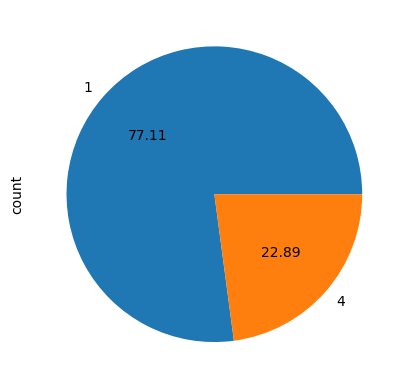

In [165]:
# Since data for Status column of Won & Lost is imbalanced, data to be balanced by SMOTE Oversampling.
# Show pie plot (Approach 1)
plot=status.plot.pie(autopct='%.2f', labels=status.index)
print(plot)


In [166]:
df_scaled.isnull().sum()

id               0
item_date        0
quantity tons    0
customer         0
country          0
status           0
item type        0
application      0
thickness        0
width            0
product_ref      0
delivery date    0
selling_price    0
dtype: int64

In [167]:
x=df_scaled[['quantity tons', 'customer', 'country', 'item type', 'application', 'thickness', 'width', 'product_ref', 'selling_price']]
y=df_scaled['status']

In [169]:

x_train, x_test, y_train, y_test= train_test_split(x,y, test_size=0.2, random_state=10)

In [170]:
x_train.shape, x_test.shape, y_train.shape, y_test.shape

((120348, 9), (30087, 9), (120348,), (30087,))

Text(0.5, 1.0, 'Over-sampling using SMOTE')

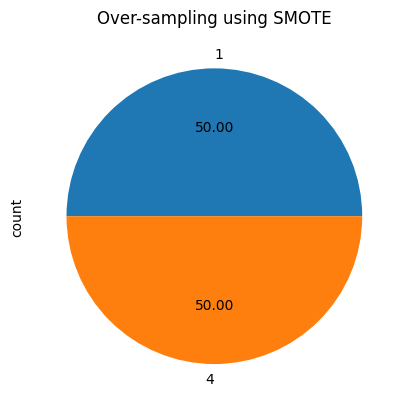

In [171]:


smote=SMOTE()

x_train_smote, y_train_smote= smote.fit_resample(x_train, y_train)

# You can check the class distribution after applying SMOTE

ax=y_train_smote.value_counts().plot.pie(autopct="%.2f")
ax.set_title("Over-sampling using SMOTE")

In [172]:
y_train_smote.value_counts()

status
1    92699
4    92699
Name: count, dtype: int64

In [173]:
print("x_train_smote shape:", x_train_smote.shape)
print("y_train_smote shape:", y_train_smote.shape)


x_train_smote shape: (185398, 9)
y_train_smote shape: (185398,)


In [177]:

model = LogisticRegression(max_iter=10000)
model.fit(x_train_smote,y_train_smote)

LogisticRegression(max_iter=10000)

In [175]:
y_predict= model.predict(x_test)
y_predict


array([1., 1., 1., ..., 1., 1., 1.])

In [178]:
from sklearn.metrics import accuracy_score
print(accuracy_score(y_test,y_predict))
pd.crosstab(y_test,y_predict)

0.7511549838800811


col_0,1.0,4.0
status,,
1,22349,726
4,6761,251


In [172]:
model.predict_proba(x_test)

array([[0.85262543, 0.14737457],
       [0.77959968, 0.22040032],
       [0.78591009, 0.21408991],
       ...,
       [0.80720905, 0.19279095],
       [0.64722827, 0.35277173],
       [0.73732853, 0.26267147]])

In [179]:
# Checking the best classifier model to predict the Status.

def best_classifier_algorithm(x_train_smote,y_train_smote, x_test, y_test, algorithm):

    # # splitting the data
    # x_train, y_train, x_test, y_test= train_test_split(x,y, test_size=0.2, random_state=10)

    # Model building
    model=algorithm.fit(x_train_smote, y_train_smote)

    # Predict for train and test accuracy

    y_train_pred = model.predict(x_train_smote)

    y_test_pred  = model.predict(x_test)

    # Accuracy score

    training=accuracy_score(y_train_smote, y_train_pred)
    testing=accuracy_score(y_test, y_test_pred)

    
    classifier={'Algorithm': model.__class__.__name__, 'Training score': training, 'Testing score': testing}

    return classifier

In [187]:
from sklearn.ensemble import RandomForestClassifier

classifier_result = best_classifier_algorithm(x_train_smote, y_train_smote, x_test, y_test, RandomForestClassifier())
print(classifier_result)

classifier_result = best_classifier_algorithm(x_train_smote, y_train_smote, x_test, y_test, ExtraTreesClassifier())
print(classifier_result)

# Initialize LabelEncoder
label_encoder = LabelEncoder()

# Fit and transform labels in y_train_smote
y_train_encoded = label_encoder.fit_transform(y_train_smote)

# Transform labels in y_test
y_test_encoded = label_encoder.transform(y_test)

# Then, proceed with training and testing your classifier
classifier_result = best_classifier_algorithm(x_train_smote, y_train_encoded, x_test, y_test_encoded, XGBClassifier())
print(classifier_result)

classifier_result = best_classifier_algorithm(x_train_smote, y_train_smote, x_test, y_test, LogisticRegression())
print(classifier_result)


c:\Users\Good Day\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\base.py:1474: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


{'Algorithm': 'RandomForestClassifier', 'Training score': 0.999929880581236, 'Testing score': 0.9364177219397082}


c:\Users\Good Day\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\base.py:1474: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


{'Algorithm': 'ExtraTreesClassifier', 'Training score': 0.9999406681841229, 'Testing score': 0.9281417223385515}


c:\Users\Good Day\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\preprocessing\_label.py:114: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


{'Algorithm': 'XGBClassifier', 'Training score': 0.919502907258978, 'Testing score': 0.8815767607272244}


c:\Users\Good Day\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1300: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


{'Algorithm': 'LogisticRegression', 'Training score': 0.6780278104402421, 'Testing score': 0.6751420879449597}


In [189]:
from sklearn.metrics import classification_report
print (classification_report(y_test, y_predict))

auc = roc_auc_score(y_test_encoded, y_pred)

# Plot ROC curve
    fpr, tpr, _ = roc_curve(y_test_encoded, y_pred)
    plt.plot(fpr, tpr, label=name)

# Plot ROC curve for all classifiers
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve')
plt.legend()
plt.show()

NameError: name 'y_predict' is not defined

In [188]:
# Since Random Forest Classifier Algorithm giving more accuracy, hence using the same for prediction.


In [ ]:
import pickle


# Assuming your model is stored in a variable called 'model'
with open('neth.pkl', 'wb') as file:
   pickle.dump(model, file)


with open('neth.pkl', 'rb') as file:
   guvi = pickle.load(file)


guvi.predict([[0,10,29]])

In [ ]:
from sklearn.metrics import classification_report, confusion_matrix
import itertools

clf.score(X_test, y_test)

y_pred = clf.predict(X_test)
confusion_matrix(y_test,y_pred)
pd.crosstab(y_test, y_pred, rownames = ['Actual'], colnames =['Predicted'], margins = True)

print (classification_report(y_test, yhat))
